In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from dataprep.eda import *
from dataprep.eda import plot
from dataprep.eda import plot_correlation
from dataprep.eda import plot_missing
import warnings
warnings.filterwarnings('ignore')

In [2]:
data = pd.read_csv('healthcare-dataset-stroke-data.csv')

In [3]:
data.head()

,id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,9046,Male,67.0,0,1,Yes,Private,Urban,228.69,36.6,formerly smoked,1
1,51676,Female,61.0,0,0,Yes,Self-employed,Rural,202.21,NaN,never smoked,1
2,31112,Male,80.0,0,1,Yes,Private,Rural,105.92,32.5,never smoked,1
3,60182,Female,49.0,0,0,Yes,Private,Urban,171.23,34.4,smokes,1
4,1665,Female,79.0,1,0,Yes,Self-employed,Rural,174.12,24.0,never smoked,1


In [4]:
data.drop(columns=['id'],inplace=True)

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5110 entries, 0 to 5109
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   gender             5110 non-null   object 
 1   age                5110 non-null   float64
 2   hypertension       5110 non-null   int64  
 3   heart_disease      5110 non-null   int64  
 4   ever_married       5110 non-null   object 
 5   work_type          5110 non-null   object 
 6   Residence_type     5110 non-null   object 
 7   avg_glucose_level  5110 non-null   float64
 8   bmi                4909 non-null   float64
 9   smoking_status     5110 non-null   object 
 10  stroke             5110 non-null   int64  
dtypes: float64(3), int64(3), object(5)
memory usage: 439.3+ KB


In [6]:
data.isnull().sum()

gender                 0
age                    0
hypertension           0
heart_disease          0
ever_married           0
work_type              0
Residence_type         0
avg_glucose_level      0
bmi                  201
smoking_status         0
stroke                 0
dtype: int64

  0%|          | 0/153 [00:00<?, ?it/s]


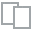
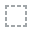
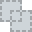
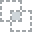
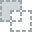
...
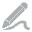
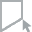
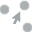
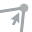
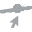

In [7]:
plot_missing(data)

In [8]:
data.bmi.replace(to_replace=np.nan, value=data.bmi.mean(),inplace=True)

In [9]:
data.describe()

,age,hypertension,heart_disease,avg_glucose_level,bmi,stroke
count,5110.000000,5110.000000,5110.000000,5110.000000,5110.000000,5110.000000
mean,43.226614,0.097456,0.054012,106.147677,28.893237,0.048728
std,22.612647,0.296607,0.226063,45.283560,7.698018,0.215320
min,0.080000,0.000000,0.000000,55.120000,10.300000,0.000000
25%,25.000000,0.000000,0.000000,77.245000,23.800000,0.000000
50%,45.000000,0.000000,0.000000,91.885000,28.400000,0.000000
75%,61.000000,0.000000,0.000000,114.090000,32.800000,0.000000
max,82.000000,1.000000,1.000000,271.740000,97.600000,1.000000


In [10]:
import pandas_profiling as pp
pp.ProfileReport(data)

Render HTML: 100%|██████████| 1/1 [00:01<00:00,  1.92s/it]


  0%|          | 0/1277 [00:00<?, ?it/s]

DataPrep Report
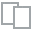
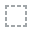
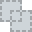
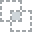
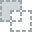
...
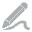
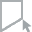
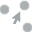
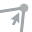
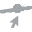

In [11]:
create_report(data)

<AxesSubplot:xlabel='stroke', ylabel='count'>

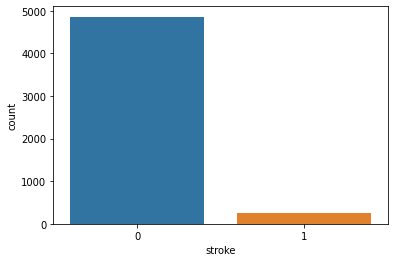

In [12]:
sns.countplot(data['stroke'])

<AxesSubplot:>

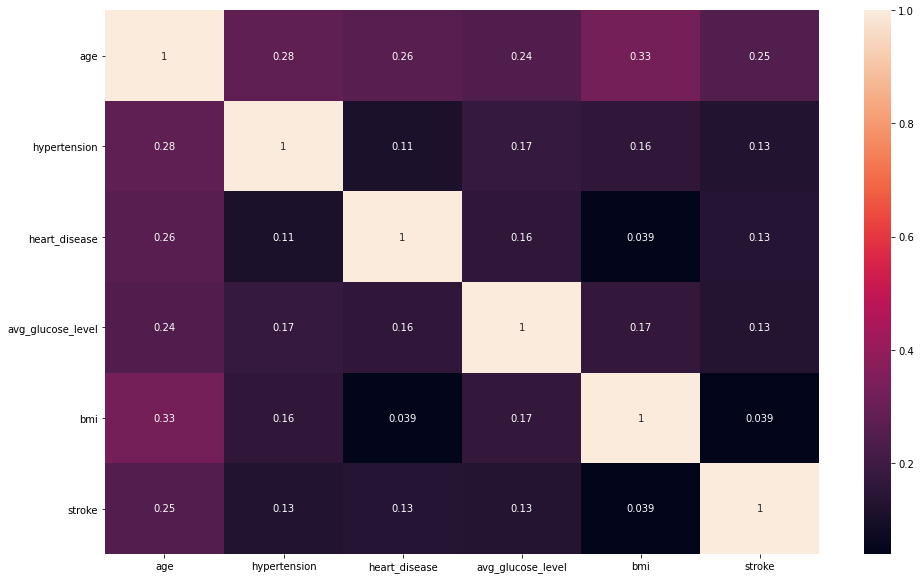

In [13]:
plt.figure(figsize=(16,10))
sns.heatmap(data.corr(method='pearson'), annot=True)

In [14]:
from sklearn.preprocessing import LabelEncoder

In [15]:
data = data[data['smoking_status']!='Unknown']

In [16]:
# gender
le = LabelEncoder()
le.fit(data.gender.drop_duplicates())
data.gender = le.transform(data.gender)

# residence type
le.fit(data.Residence_type.drop_duplicates())
data.Residence_type = le.transform(data.Residence_type)

# ever married
le.fit(data.ever_married.drop_duplicates())
data.ever_married = le.transform(data.ever_married)

# smoking status
le.fit(data.smoking_status.drop_duplicates())
data.smoking_status = le.transform(data.smoking_status)

# work type
le.fit(data.work_type.drop_duplicates())
data.work_type = le.transform(data.work_type)

In [17]:
data

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,1,67.0,0,1,1,2,1,228.69,36.600000,0,1
1,0,61.0,0,0,1,3,0,202.21,28.893237,1,1
2,1,80.0,0,1,1,2,0,105.92,32.500000,1,1
3,0,49.0,0,0,1,2,1,171.23,34.400000,2,1
4,0,79.0,1,0,1,3,0,174.12,24.000000,1,1
...,...,...,...,...,...,...,...,...,...,...,...
5102,0,57.0,0,0,1,2,0,77.93,21.700000,1,0
5105,0,80.0,1,0,1,2,1,83.75,28.893237,1,0
5106,0,81.0,0,0,1,3,1,125.20,40.000000,1,0
5107,0,35.0,0,0,1,3,0,82.99,30.600000,1,0


In [18]:
x = data.drop(["stroke"] , axis = 1)
y = data["stroke"]

In [19]:
x.isnull().sum()

gender               0
age                  0
hypertension         0
heart_disease        0
ever_married         0
work_type            0
Residence_type       0
avg_glucose_level    0
bmi                  0
smoking_status       0
dtype: int64

In [20]:
from imblearn.over_sampling import SMOTE

smote = SMOTE()
x_smote, y_smote = smote.fit_resample(x, y)

In [21]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x_smote, y_smote, test_size=0.2, random_state=0)

In [22]:
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()

x_train = sc.fit_transform(x_train)
x_test = sc.transform(x_test)

In [23]:
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import confusion_matrix, roc_auc_score, precision_score, recall_score, f1_score, accuracy_score, classification_report, roc_curve, auc
from sklearn.model_selection import cross_val_score

In [68]:
models = []
models.append(['Logistic Regression', LogisticRegression(random_state = 1)])
models.append(['Support Vector Machine (RBF Classifier)', SVC(kernel = 'rbf', random_state = 1)])
models.append(['XGBClassifier', XGBClassifier()])
models.append(['RandomForest', RandomForestClassifier(random_state = 1)])
models.append(['AdaBoostClassifier', AdaBoostClassifier(base_estimator = models[3][1], n_estimators=100, random_state = 1)])

In [69]:
arr1 = []
for i in range(len(models)):
    arr2 = []
    model = models[i][1]
    model.fit(x_train, y_train)
    y_pred = model.predict(x_test)
    
    train_accuracies = model.score(x_train, y_train) * 100
    cm = confusion_matrix(y_test, y_pred)
    cr = classification_report(y_test, y_pred)
    accuracies = cross_val_score(estimator = model, X = x_train , y = y_train, cv = 5)
    roc_auc = roc_auc_score(y_test, y_pred)

    print(models[i][0] + " Reports:")
    print("Training Accuracy: {}".format(train_accuracies))
    print(cm)
    print(cr)
    print('K-Fold Validation Mean Accuracy: {}'.format(accuracies.mean()*100))
    print('Standard Deviation: {}'.format(accuracies.std()*100))
    print('ROC AUC Score: {}'.format(roc_auc))
    print("---"*20)


Logistic Regression Reports:
Training Accuracy: 78.16796729840209
[[513 155]
 [144 534]]
              precision    recall  f1-score   support

           0       0.78      0.77      0.77       668
           1       0.78      0.79      0.78       678

    accuracy                           0.78      1346
   macro avg       0.78      0.78      0.78      1346
weighted avg       0.78      0.78      0.78      1346

K-Fold Validation Mean Accuracy: 78.07537114316581
Standard Deviation: 1.2199682034607184
ROC AUC Score: 0.7777873456626571
------------------------------------------------------------
Support Vector Machine (RBF Classifier) Reports:
Training Accuracy: 85.67447045707915
[[527 141]
 [ 90 588]]
              precision    recall  f1-score   support

           0       0.85      0.79      0.82       668
           1       0.81      0.87      0.84       678

    accuracy                           0.83      1346
   macro avg       0.83      0.83      0.83      1346
weighted avg      